In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
import os
import plotly.express as px
from plotly.subplots import make_subplots

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from scipy.spatial.distance import cdist
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import MinMaxScaler, RobustScaler, StandardScaler
from sklearn.decomposition import PCA
from category_encoders import CountEncoder, OneHotEncoder

from sklearn.metrics.pairwise import euclidean_distances
from sklearn.metrics       import silhouette_score, davies_bouldin_score, calinski_harabasz_score
from umap import UMAP
import re

In [2]:
random_state = 42
np.random.seed(random_state)

In [3]:
data_df = pd.read_csv('SpotifyDataset/data.csv')
data_artist = pd.read_csv('SpotifyDataset/data_by_artist.csv')
data_genres = pd.read_csv('SpotifyDataset/data_by_genres.csv')
data_years = pd.read_csv('SpotifyDataset/data_by_year.csv')
data_wgenres = pd.read_csv('SpotifyDataset/data_w_genres.csv')

In [4]:
data_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [5]:
data_artist.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28680 entries, 0 to 28679
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              28680 non-null  int64  
 1   count             28680 non-null  int64  
 2   acousticness      28680 non-null  float64
 3   artists           28680 non-null  object 
 4   danceability      28680 non-null  float64
 5   duration_ms       28680 non-null  float64
 6   energy            28680 non-null  float64
 7   instrumentalness  28680 non-null  float64
 8   liveness          28680 non-null  float64
 9   loudness          28680 non-null  float64
 10  speechiness       28680 non-null  float64
 11  tempo             28680 non-null  float64
 12  valence           28680 non-null  float64
 13  popularity        28680 non-null  float64
 14  key               28680 non-null  int64  
dtypes: float64(11), int64(3), object(1)
memory usage: 3.3+ MB


In [6]:
data_genres.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB


In [7]:
data_years.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB


In [8]:
data_wgenres.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28680 entries, 0 to 28679
Data columns (total 16 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   genres            28680 non-null  object 
 1   artists           28680 non-null  object 
 2   acousticness      28680 non-null  float64
 3   danceability      28680 non-null  float64
 4   duration_ms       28680 non-null  float64
 5   energy            28680 non-null  float64
 6   instrumentalness  28680 non-null  float64
 7   liveness          28680 non-null  float64
 8   loudness          28680 non-null  float64
 9   speechiness       28680 non-null  float64
 10  tempo             28680 non-null  float64
 11  valence           28680 non-null  float64
 12  popularity        28680 non-null  float64
 13  key               28680 non-null  int64  
 14  mode              28680 non-null  int64  
 15  count             28680 non-null  int64  
dtypes: float64(11), int64(3), object(2)
memo

In [9]:
data = data_df.copy()
data['decade'] = data['year'].apply(lambda year : (year//10)*10 )
data_df.columns

Index(['valence', 'year', 'acousticness', 'artists', 'danceability',
       'duration_ms', 'energy', 'explicit', 'id', 'instrumentalness', 'key',
       'liveness', 'loudness', 'mode', 'name', 'popularity', 'release_date',
       'speechiness', 'tempo'],
      dtype='object')

In [10]:
# sns.countplot(data['decade'])

In [11]:
object_columns = data.select_dtypes(include=['object']).columns.tolist()
object_columns.append('year')
dataNum = data.loc[:, ~data.columns.isin(object_columns)]
dataNum = dataNum.groupby(['decade']).mean()
# len(dataNum.columns)
dataNum

,valence,acousticness,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo
decade,,,,,,,,,,,,,,
1920,0.542143,0.801554,0.586963,183769.229419,0.235133,0.133632,0.377181,5.405579,0.210910,-16.699090,0.694108,1.304331,0.291475,110.431253
1930,0.567896,0.867694,0.541664,207616.599539,0.286655,0.061891,0.276707,5.310713,0.225639,-14.214586,0.693266,2.536601,0.204065,111.545690
1940,0.487830,0.870974,0.473476,217894.653661,0.254896,0.071076,0.363176,5.178697,0.221343,-15.331419,0.702042,1.876252,0.153847,107.379639
1950,0.478597,0.840334,0.476858,220482.874358,0.286753,0.007758,0.247795,5.030227,0.209219,-14.731226,0.710882,10.692091,0.093679,110.972049
1960,0.551939,0.624013,0.494697,211668.431071,0.414520,0.000563,0.157578,5.107269,0.208687,-12.676736,0.753952,26.551742,0.057731,115.166468
1970,0.585098,0.400162,0.524927,254051.705500,0.533716,0.003550,0.116031,5.088750,0.216406,-11.424966,0.743200,35.055800,0.059764,119.858574
1980,0.564420,0.298634,0.546385,252120.366045,0.594715,0.023224,0.122269,5.270932,0.204639,-11.226990,0.709874,37.523426,0.062035,121.345255
1990,0.544997,0.307533,0.566082,248595.562535,0.586066,0.115120,0.109744,5.330235,0.196547,-10.004415,0.723079,44.192252,0.080528,119.404234
2000,0.530295,0.269761,0.574142,239517.406953,0.651586,0.141301,0.083848,5.282297,0.195582,-7.501916,0.685483,49.734348,0.087719,121.254695


In [12]:
columns = [col for col in dataNum.columns if col != 'decade']

fig = make_subplots(rows=7, cols=2, subplot_titles=[f'{col} vs decade' for col in columns], vertical_spacing=0.05)

# Loop through the columns and add line plots to subplots
for i, colm in enumerate(columns):
    row = i // 2 + 1
    col = i % 2 + 1
    fig_col = px.line(dataNum, x=dataNum.index, y=dataNum[colm], title=f'{colm} vs decade')  # Assuming index is the x-axis
    for trace in fig_col.data:
        fig.add_trace(trace, row=row, col=col)
        fig.update_yaxes(title_text=colm, row=row, col=col)
fig.update_layout(
    title_text='Detailed Variation of Attributes by Decade',
    height=2100,  # Set total height based on number of rows
)
fig.show()

In [13]:
top10_genres = data_genres.nlargest(10, 'popularity')

fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group',
            title='Trend of various sound features over top 10 genres')

fig.update_layout(
    height=500, 
)
fig.show()

In [14]:
X = data_genres.select_dtypes(np.number)
cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=12))])
cluster_pipeline.fit(X)
data_genres['cluster'] = cluster_pipeline.predict(X)


In [15]:
data_genres['cluster'].value_counts()

cluster
2     619
8     363
7     360
9     333
5     328
0     282
3     268
6     189
11    146
1      57
4      22
10      6
Name: count, dtype: int64

In [16]:
from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('pca', PCA(n_components=2))])
principal_components = pca_pipeline.fit_transform(X)  # X is your original data
pca_df = pd.DataFrame(data=principal_components, columns=['PC1', 'PC2'])
pca_df['cluster'] = data_genres['cluster']

fig = px.scatter(pca_df, x='PC1', y='PC2', color='cluster',
                 title='Clusters of Genres')

fig.update_layout(
    xaxis_title='Principal Component 1',
    yaxis_title='Principal Component 2',
    height=600
    
)

fig.show()


In [17]:
X = data.select_dtypes(np.number)
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=25))])
song_cluster_pipeline.fit(X)
data['cluster'] = song_cluster_pipeline.predict(X)

In [18]:
print(data.columns)
print(data_df.columns)

Index(['valence', 'year', 'acousticness', 'artists', 'danceability',
       'duration_ms', 'energy', 'explicit', 'id', 'instrumentalness', 'key',
       'liveness', 'loudness', 'mode', 'name', 'popularity', 'release_date',
       'speechiness', 'tempo', 'decade', 'cluster'],
      dtype='object')
Index(['valence', 'year', 'acousticness', 'artists', 'danceability',
       'duration_ms', 'energy', 'explicit', 'id', 'instrumentalness', 'key',
       'liveness', 'loudness', 'mode', 'name', 'popularity', 'release_date',
       'speechiness', 'tempo'],
      dtype='object')


In [19]:
from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('pca', PCA(n_components=2))])
principal_components = pca_pipeline.fit_transform(X)  # X is your original data
pca_df = pd.DataFrame(data=principal_components, columns=['PC1', 'PC2'])
pca_df['cluster'] = data['cluster']

fig = px.scatter(pca_df, x='PC1', y='PC2', color='cluster',
                 title='Clusters of Songs')

fig.update_layout(
    xaxis_title='Principal Component 1',
    yaxis_title='Principal Component 2',
    height=600
    
)

fig.show()


In [20]:
data = data_df.drop_duplicates(subset=['artists', 'name']) # dropping duplicates
data = data.loc[data['name'].str.contains("[a-zA-Z]+"), :]
data.loc[:, 'artists_main'] = data['artists'].apply(lambda i: re.search(r"([\w|\s]+)", i).group(0).lower())
data.loc[:, 'artists_num'] = data['artists'].str.count("(['\w\s\d]+)+")

In [21]:
data.head()

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,...,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,artists_main,artists_num
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,...,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954,sergei rachmaninoff,3
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,...,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936,dennis day,1
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,...,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339,khp kridhamardawa karaton ngayogyakarta hadini...,1
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,...,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109,frank parker,1
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,...,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665,phil regan,1


In [22]:
data = data.loc[data['year'] >= 1950, :]

In [23]:
data.shape

(128385, 21)

In [24]:
X = data.drop(columns=['id', 'key', 'name', 'year', 'release_date', 'artists'])

In [25]:
min_max_scaler_columns = [
    'valence', 'acousticness', 'danceability', 'duration_ms', 'energy', 'artists_num',
    'instrumentalness', 'liveness', 'loudness', 'popularity', 'speechiness', 'tempo']
count_encoder_columns = ['artists_main']

ct = ColumnTransformer(
    transformers=[
        ('minmax_scaler', MinMaxScaler(), min_max_scaler_columns),
        ('count_encoder', CountEncoder(return_df=False, normalize=True), count_encoder_columns)
    ], remainder='passthrough')

ct

ColumnTransformer(remainder='passthrough',
                  transformers=[('minmax_scaler', MinMaxScaler(),
                                 ['valence', 'acousticness', 'danceability',
                                  'duration_ms', 'energy', 'artists_num',
                                  'instrumentalness', 'liveness', 'loudness',
                                  'popularity', 'speechiness', 'tempo']),
                                ('count_encoder',
                                 CountEncoder(combine_min_nan_groups=True,
                                              normalize=True, return_df=False),
                                 ['artists_main'])])

In [26]:
X_norm = ct.fit_transform(X)
X_norm = pd.DataFrame(X_norm, columns=ct.get_feature_names_out())

In [27]:
X_norm.shape

(128385, 15)

In [28]:
n_clusters = np.arange(2, 20)

davies_bouldin_score_dict = {}

for cluster in n_clusters:
    
    kmeans = KMeans(n_init='auto', n_clusters=cluster, random_state=random_state)

    y = kmeans.fit_predict(X_norm)

    db = davies_bouldin_score(X_norm, y)

    davies_bouldin_score_dict[cluster] = db
    
davies_bouldin_score_dict

{np.int64(2): np.float64(1.7829551974674482),
 np.int64(3): np.float64(1.3655164120434469),
 np.int64(4): np.float64(1.332676270239003),
 np.int64(5): np.float64(1.211031480691077),
 np.int64(6): np.float64(1.4009908239414155),
 np.int64(7): np.float64(1.4035188834527126),
 np.int64(8): np.float64(1.3719000073382632),
 np.int64(9): np.float64(1.4122282952170213),
 np.int64(10): np.float64(1.3337980051590068),
 np.int64(11): np.float64(1.2919673156339826),
 np.int64(12): np.float64(1.2829201263486916),
 np.int64(13): np.float64(1.3186919090940694),
 np.int64(14): np.float64(1.2851525351218076),
 np.int64(15): np.float64(1.3581019746474026),
 np.int64(16): np.float64(1.3915486585332417),
 np.int64(17): np.float64(1.4043334911148178),
 np.int64(18): np.float64(1.5208832167203727),
 np.int64(19): np.float64(1.5629981186656974)}

In [29]:
kmeans = KMeans(n_init='auto', n_clusters=8, random_state=42)
y = kmeans.fit_predict(X_norm)

In [30]:
df_aux = pd.DataFrame({})

umap = UMAP(n_components=2)
df_aux[['umap_1', 'umap_2']] = umap.fit_transform(X_norm)

df_aux['Cluster'] = y

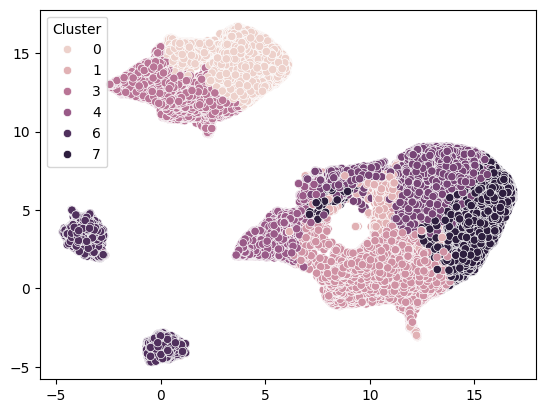

In [31]:
sns.scatterplot(x='umap_1', y='umap_2', hue='Cluster', data=df_aux)
plt.xlabel('')
plt.ylabel('');

In [32]:
%%time

n_clusters = np.arange(2, 30)

davies_bouldin_score_dict = {}

pca = PCA(random_state=42, n_components=0.9)
X_pca = pca.fit_transform(X_norm)

for cluster in n_clusters:

    kmeans = KMeans(n_init='auto', n_clusters=cluster, random_state=42)
    y = kmeans.fit_predict(X_pca)

    db = davies_bouldin_score(X_pca, y)
    
    davies_bouldin_score_dict[cluster] = db
    
davies_bouldin_score_dict

CPU times: total: 12.8 s
Wall time: 6.67 s


{np.int64(2): np.float64(1.3316746430465263),
 np.int64(3): np.float64(1.241534342364875),
 np.int64(4): np.float64(1.113721420667229),
 np.int64(5): np.float64(1.1426657777397224),
 np.int64(6): np.float64(1.102630742596494),
 np.int64(7): np.float64(1.20749290440445),
 np.int64(8): np.float64(1.13684900698171),
 np.int64(9): np.float64(1.073115366381423),
 np.int64(10): np.float64(1.1278971404843825),
 np.int64(11): np.float64(1.145127485502862),
 np.int64(12): np.float64(1.117108069752167),
 np.int64(13): np.float64(1.1036046631589431),
 np.int64(14): np.float64(1.0818572929589796),
 np.int64(15): np.float64(1.138198562106353),
 np.int64(16): np.float64(1.1498998681452817),
 np.int64(17): np.float64(1.1805892580520512),
 np.int64(18): np.float64(1.1463698986948958),
 np.int64(19): np.float64(1.1526623135238363),
 np.int64(20): np.float64(1.1422176559326542),
 np.int64(21): np.float64(1.2641600302616807),
 np.int64(22): np.float64(1.287970627335562),
 np.int64(23): np.float64(1.35274

Text(0, 0.5, '')

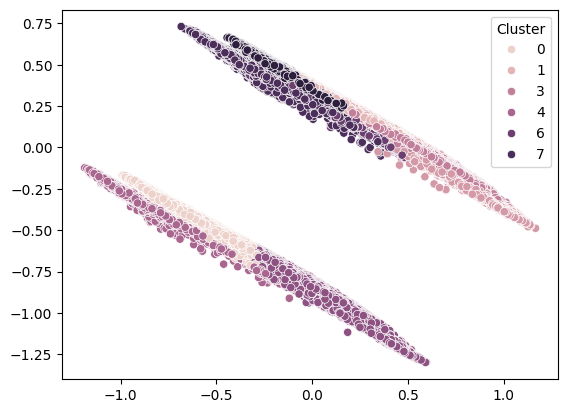

In [33]:
kmeans = KMeans(n_init='auto', n_clusters=9, random_state=42)
y = kmeans.fit_predict(X_pca)

df_aux = pd.DataFrame(X_pca)
df_aux['Cluster'] = y

sns.scatterplot(x=0, y=1, hue='Cluster', data=df_aux)
plt.xlabel('')
plt.ylabel('')

In [34]:
%%time

n_clusters = np.arange(2, 20)
n_components = np.arange(2, 15)

dict_davies_bouldin_score_pca = {}


for cluster in n_clusters:

    dict_davies_bouldin_score_pca[cluster] = []

    for comp in n_components:

        pipe = Pipeline(
            [
                ('pca', PCA(n_components=comp, random_state=42)),
                ('kmeans', KMeans(n_init='auto', n_clusters=cluster, random_state=42))
            ]
        )

        X_pca = pipe['pca'].fit_transform(X_norm)
        y = pipe['kmeans'].fit_predict(X_pca)

        db = davies_bouldin_score(X_pca, y)

        dict_davies_bouldin_score_pca[cluster].append(db)

CPU times: total: 2min 2s
Wall time: 44.3 s


In [35]:
pd.DataFrame(dict_davies_bouldin_score_pca, index=n_components)

,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
2,0.802951,0.567767,0.493109,0.518173,0.530798,0.545602,0.554883,0.568779,0.574467,0.575277,0.580910,0.581953,0.584169,0.583829,0.583628,0.587196,0.589431,0.589173
3,0.991983,0.797124,0.781444,0.715251,0.684404,0.726015,0.798715,0.746848,0.769038,0.795938,0.821434,0.815679,0.787919,0.799736,0.814071,0.810575,0.797284,0.809400
4,1.450838,0.954526,0.982324,0.994876,0.880721,0.899646,0.768974,0.813112,0.872599,0.884077,0.909330,0.910380,0.904749,0.854389,0.869051,0.895758,0.893256,0.881888
5,1.229963,1.075281,0.989278,0.993386,0.938234,0.950702,0.926771,0.918184,0.904792,0.889194,0.933425,0.946712,0.895542,0.833342,0.837540,0.842448,0.900948,0.882197
6,1.292476,1.186860,1.132699,1.169954,1.051710,1.056676,1.047315,1.106880,1.142717,1.178264,1.124785,1.137276,1.067485,1.162298,1.123588,1.149472,1.108356,1.119265
7,1.331675,1.241534,1.113721,1.142666,1.102631,1.207493,1.136849,1.073115,1.127897,1.145127,1.117108,1.103605,1.081857,1.138199,1.149900,1.180589,1.146370,1.152662
8,1.367314,1.288284,1.340586,1.547438,1.155938,1.277138,1.160854,1.143915,1.227088,1.215605,1.181160,1.118245,1.180641,1.238815,1.351034,1.385477,1.344120,1.343289
9,1.743908,1.321874,1.282604,1.325181,1.310148,1.214288,1.157106,1.147370,1.178379,1.186112,1.251283,1.228369,1.356972,1.366916,1.486094,1.497554,1.557737,1.479025
10,1.410084,1.346350,1.310503,1.188486,1.224537,1.305772,1.285276,1.229729,1.217923,1.294238,1.352823,1.325942,1.383193,1.396800,1.441412,1.497377,1.503781,1.446051
11,1.420944,1.359979,1.325511,1.371477,1.241041,1.266742,1.299176,1.251496,1.333009,1.303616,1.292289,1.248236,1.323926,1.339686,1.359973,1.427486,1.434404,1.507103


In [36]:
pipe = Pipeline([('pca', PCA(n_components=2, random_state=random_state)), ('kmeans', KMeans(n_init='auto', n_clusters=4, random_state=random_state))])

X_pca = pipe['pca'].fit_transform(X_norm)
y = pipe['kmeans'].fit_predict(X_pca)

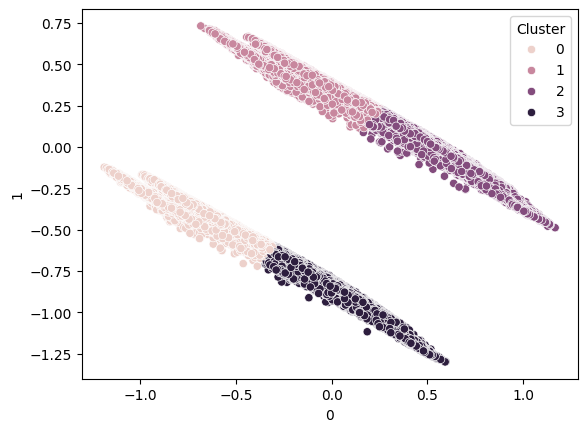

In [37]:
df_aux = pd.DataFrame(X_pca)
df_aux['Cluster'] = y

sns.scatterplot(x=0, y=1, hue='Cluster', data=df_aux);

In [38]:
min_max_scaler_columns = [
    'valence', 'acousticness', 'danceability', 'duration_ms', 'energy', 
    'instrumentalness', 'liveness', 'loudness', 'popularity', 'speechiness', 'tempo']
onehot_encoder_columns = ['artists_main']

ct = ColumnTransformer(
    transformers=[
        ('minmax_scaler', MinMaxScaler(), min_max_scaler_columns),
        ('count_encoder', CountEncoder(return_df=False, normalize=True), onehot_encoder_columns)
    ], remainder='passthrough')

pipe = Pipeline(
    [
        ('column_transformer', ct),
        ('pca', PCA(n_components=2, random_state=random_state)),
        ('kmeans', KMeans(n_init='auto', n_clusters=4, random_state=random_state))
    ])

pipe

Pipeline(steps=[('column_transformer',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('minmax_scaler',
                                                  MinMaxScaler(),
                                                  ['valence', 'acousticness',
                                                   'danceability',
                                                   'duration_ms', 'energy',
                                                   'instrumentalness',
                                                   'liveness', 'loudness',
                                                   'popularity', 'speechiness',
                                                   'tempo']),
                                                 ('count_encoder',
                                                  CountEncoder(combine_min_nan_groups=True,
                                                               normalize=True,
                                                               return_df=False),
                                                  ['artists_main'])])),
                ('pca', PCA(n_components=2, random_state=42)),
                ('kmeans', KMeans(n_clusters=4, random_state=42))])

In [39]:
X_norm = pipe['column_transformer'].fit_transform(X)
X_pca = pipe['pca'].fit_transform(X_norm)

data[['pca_1', 'pca_2']] = X_pca
data['Cluster'] = pipe.fit_predict(X)

In [47]:
song = 'Baby'
artist_main = 'justin bieber'
n_cluster = data.loc[data['name'] == song, 'Cluster'].values[0]
df_music = data.loc[(data['name'] == song) & (data['artists_main'] == artist_main), ['pca_1', 'pca_2']]
df_music
group = data.loc[data['Cluster'] == n_cluster, :]
group.loc[:, 'distances'] = euclidean_distances(group[['pca_1', 'pca_2']], df_music)
data

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,...,name,popularity,release_date,speechiness,tempo,artists_main,artists_num,pca_1,pca_2,Cluster
5606,0.197,1950,0.99000,['Ella Fitzgerald'],0.354,196667,0.0851,0,5RcvlmVx2xtFcp2Ta5pw7X,0.000004,...,Someone To Watch Over Me,56,1950-09-11,0.0345,97.684,ella fitzgerald,1,-0.362548,0.734502,3
5607,0.258,1950,0.98600,['Ella Fitzgerald'],0.455,196440,0.1060,0,5DIVWgTeJ2fPIxaY9e7ZKn,0.000000,...,I've Got A Crush On You,55,1950-09-11,0.0422,66.807,ella fitzgerald,1,-0.364834,0.707261,3
5608,0.345,1950,0.96000,['Hoagy Carmichael'],0.658,146347,0.0542,0,0VX8ptOQhUt1SIOHYLZGNN,0.106000,...,Stardust,42,1950-01-01,0.0596,90.138,hoagy carmichael,1,-0.364582,0.715031,3
5609,0.951,1950,0.83000,['Lefty Frizzell'],0.545,179307,0.3920,0,3jvNwwHkWjELV3QALVz47D,0.000094,...,If You've Got the Money I've Got the Time,43,1950,0.0481,208.426,lefty frizzell,1,-0.407033,0.373413,3
5610,0.540,1950,0.95800,"['Dean Martin', 'Paul Weston And His Orchestra']",0.498,155107,0.2210,0,7Eo3ow9Owy5iAoulBtE3Mq,0.053000,...,Powder Your Face With Sunshine (Smile! Smile! ...,37,1950,0.0450,168.748,dean martin,2,0.625539,-0.046195,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170648,0.608,2020,0.08460,"['Anuel AA', 'Daddy Yankee', 'KAROL G', 'Ozuna...",0.786,301714,0.8080,0,0KkIkfsLEJbrcIhYsCL7L5,0.000289,...,China,72,2020-05-29,0.0881,105.029,anuel aa,5,3.528503,-0.399559,2
170649,0.734,2020,0.20600,['Ashnikko'],0.717,150654,0.7530,0,0OStKKAuXlxA0fMH54Qs6E,0.000000,...,Halloweenie III: Seven Days,68,2020-10-23,0.0605,137.936,ashnikko,1,-0.452281,-0.134017,0
170650,0.637,2020,0.10100,['MAMAMOO'],0.634,211280,0.8580,0,4BZXVFYCb76Q0Klojq4piV,0.000009,...,AYA,76,2020-11-03,0.0809,91.688,mamamoo,1,-0.450880,-0.831507,0
170651,0.195,2020,0.00998,['Eminem'],0.671,337147,0.6230,1,5SiZJoLXp3WOl3J4C8IK0d,0.000008,...,Darkness,70,2020-01-17,0.3080,75.055,eminem,1,-0.407073,-0.334779,0


In [44]:
group[['artists', 'name', 'distances', 'pca_1', 'pca_2']].sort_values('distances', ascending=True).head(10)

,artists,name,distances,pca_1,pca_2
17629,"['Justin Bieber', 'Ludacris']",Baby,0.000000,0.545150,-0.900716
17109,['Mary J. Blige'],Just Fine,0.001282,0.544027,-0.901333
18480,"['Ariana Grande', 'Iggy Azalea']",Problem,0.001335,0.543837,-0.900475
137477,"['Daddy Yankee', 'Don Omar']",Gata Gangster,0.002185,0.544719,-0.898574
91047,"['Calvin Harris', 'HAIM']",Pray to God (feat. HAIM),0.002219,0.544088,-0.898768
53274,['*NSYNC'],It Makes Me Ill,0.002727,0.543316,-0.898698
11481,['AC/DC'],Girls Got Rhythm,0.003069,0.545315,-0.903780
124481,"['Billie Eilish', 'Sofi Tukker']",COPYCAT - Sofi Tukker Remix,0.003330,0.545267,-0.897388
72259,"['Rihanna', 'Sean Paul']",Break It Off,0.003399,0.542794,-0.903164
35573,['Panic! At The Disco'],London Beckoned Songs About Money Written by M...,0.003591,0.547829,-0.903108
